<a href="https://colab.research.google.com/github/dong-uk-kim97/Aiffel_project/blob/main/Going_Deeper_semantic_segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [35]:
# ! pip uninstall -y tensorflow
# ! pip uninstall -y numpy
# ! pip uninstall -y albumentations
# ! pip install tensorflow==2.6.0
# ! pip install numpy==1.21.4
# ! pip install Pillow==8.3.2
# ! pip install albumentations==1.1.0
# ! pip uninstall -y keras
# ! pip install keras==2.6.0

Found existing installation: tensorflow 2.6.0+zzzcolab20220506153740
Uninstalling tensorflow-2.6.0+zzzcolab20220506153740:
  Successfully uninstalled tensorflow-2.6.0+zzzcolab20220506153740
ERROR: Operation cancelled by user
Found existing installation: numpy 1.21.4
Uninstalling numpy-1.21.4:
  Successfully uninstalled numpy-1.21.4
Found existing installation: albumentations 1.1.0
Uninstalling albumentations-1.1.0:
  Successfully uninstalled albumentations-1.1.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 564.4 MB 2.6 kB/s 
  Using cached numpy-1.19.5-cp37-cp37m-manylinux2010_x86_64.whl (14.8 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
xarray-einstats 0.2.2 requires numpy>=1.21, but you have numpy 1.19.5 which is incompatible.
torchvision 0.13.1+cu113 requires

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached numpy-1.21.4-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.whl (15.7 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.13.1+cu113 requires pillow!=8.3.*,>=5.3.0, but you have pillow 8.3.2 which is incompatible.
tensorflow 2.6.0+zzzcolab20220506153740 requires numpy~=1.19.2, but you have numpy 1.21.4 which is incompatible.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached albumentations-1.1.0-py3-none-any.whl (102 kB)


Found existing installation: keras 2.6.0
Uninstalling keras-2.6.0:
  Successfully uninstalled keras-2.6.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached keras-2.6.0-py2.py3-none-any.whl (1.3 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.6.0+zzzcolab20220506153740 requires numpy~=1.19.2, but you have numpy 1.21.4 which is incompatible.


In [ ]:
import tensorflow as tf
import numpy as np
import PIL
import skimage
import albumentations

print(tf.__version__)
print(np.__version__)
print(PIL.__version__)
print(skimage.__version__)
print(albumentations.__version__)

2.6.0
1.21.4
8.3.2
0.18.3
1.1.0


# KITTI Dataset 구축

In [ ]:
import os
import math
from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

In [ ]:
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

def build_augmentation(is_train=True):
  if is_train:    # 훈련용 데이터일 경우
    return Compose([
                    HorizontalFlip(p=0.5),    # 50%의 확률로 좌우대칭
                    RandomSizedCrop(         # 50%의 확률로 RandomSizedCrop
                        min_max_height=(300, 370),
                        w2h_ratio=370/1242,
                        height=224,
                        width=224,
                        p=0.5
                        ),
                    Resize(              # 입력이미지를 224X224로 resize
                        width=224,
                        height=224
                        )
                    ])
  return Compose([      # 테스트용 데이터일 경우에는 224X224로 resize만 수행합니다. 
                Resize(
                    width=224,
                    height=224
                    )
                ])

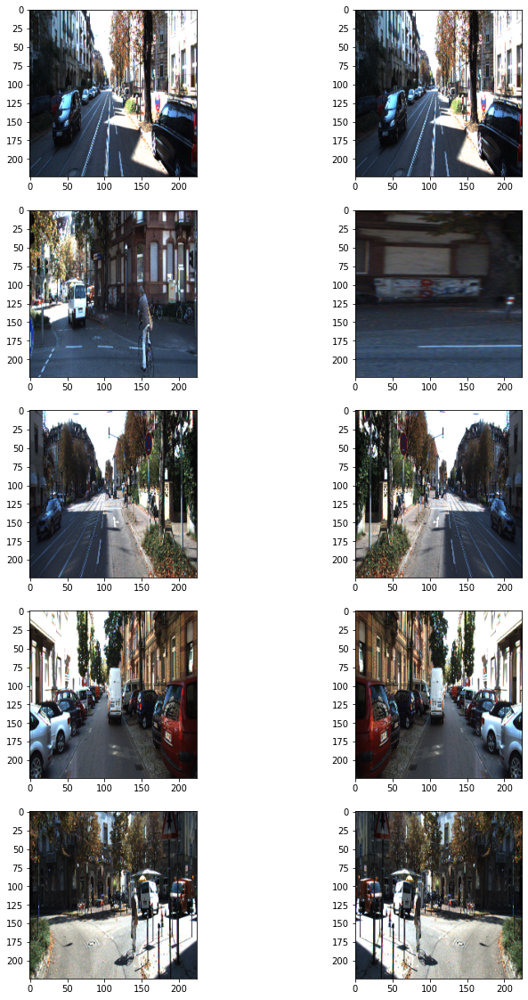

In [ ]:
dir_path = '/content/drive/MyDrive/semantic_segmentation/training'

augmentation_train= build_augmentation()
augmentation_test= build_augmentation(is_train=False)
input_images=glob(os.path.join(dir_path, 'image_2','*.png'))

# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용해 봅시다.  
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지
  
plt.show()

# KittiGenerator 생성

In [ ]:
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=16,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]

    if self.is_train:
      return data[:-30]
    return data[-30:]
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size) # ceil 함수는 실수를 입력하면 올림 하여 정수를 반환하는 함수

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    # __getitem__은 객체 슬라이싱을 위한 함수
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
      return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [ ]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)

train_generator = KittiGenerator(
    dir_path,
    augmentation = augmentation,
)

test_generator = KittiGenerator(
    dir_path,
    augmentation = test_preproc,
    is_train=False
)

# 모델 구조 만들기

In [ ]:
def build_model(input_shape=(224, 224, 3)):
    inputs = Input(input_shape)
    
    #Contracting Path
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)
    
    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool4)  
    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv5)
    
    #Expanding Path
    drop5 = Dropout(0.5)(conv5)
    up6 = Conv2DTranspose(512, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(drop5)
    merge6 = concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv6)
    up7 = Conv2DTranspose(256, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv6)
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv7)
    up8 = Conv2DTranspose(128, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv7)
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv8)
    up9 = Conv2DTranspose(64, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv8)
    merge9 = concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)  
    conv9 = Conv2D(2, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)     
    conv10 = Conv2D(1, 1, activation='sigmoid')(conv9)

    model = Model(inputs = inputs, outputs = conv10)
    return model

In [ ]:
unet = build_model()
unet.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 112, 112, 64) 0           conv2d_1[0][0]                   
______________________________________________________________________________________________

In [ ]:
unet.compile(optimizer=Adam(1e-4),loss='binary_crossentropy')
unet.fit(
    x=train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
 )

model_path = '/content/drive/MyDrive/semantic_segmentation/training/seg_model_unet.h5'
unet.save(model_path)

Epoch 1/100
11/11 [==============================] - 25s 644ms/step - loss: 0.6900 - val_loss: 0.6843
Epoch 2/100
11/11 [==============================] - 7s 609ms/step - loss: 0.6400 - val_loss: 0.4601
Epoch 3/100
11/11 [==============================] - 7s 601ms/step - loss: 0.0820 - val_loss: 0.0373
Epoch 4/100
11/11 [==============================] - 6s 590ms/step - loss: 0.0334 - val_loss: 0.0341
Epoch 5/100
11/11 [==============================] - 6s 587ms/step - loss: 0.0304 - val_loss: 0.0312
Epoch 6/100
11/11 [==============================] - 6s 583ms/step - loss: 0.0389 - val_loss: 0.0382
Epoch 7/100
11/11 [==============================] - 6s 580ms/step - loss: 0.0336 - val_loss: 0.0345
Epoch 8/100
11/11 [==============================] - 6s 579ms/step - loss: 0.0469 - val_loss: 0.0380
Epoch 9/100
11/11 [==============================] - 6s 580ms/step - loss: 0.0358 - val_loss: 0.0339
Epoch 10/100
11/11 [==============================] - 6s 588ms/step - loss: 0.0324 - val_l

# U-Net 시각화

In [ ]:
model_path = dir_path + '/seg_model_unet.h5' 

model = tf.keras.models.load_model(model_path)

In [ ]:
def get_output(model, preproc, image_path, output_path):
     origin_img = imread(image_path)
     data = {"image":origin_img}
     processed = preproc(**data)
     output = model(np.expand_dims(processed["image"]/255,axis=0))
     output = (output[0].numpy()>0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
     output = Image.fromarray(output)
     background = Image.fromarray(origin_img).convert('RGBA')
     output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
     output = Image.blend(background, output, alpha=0.5)
     output.show()
     return output

RGBA = RGB에다가 투명도(alpha)까지 반영



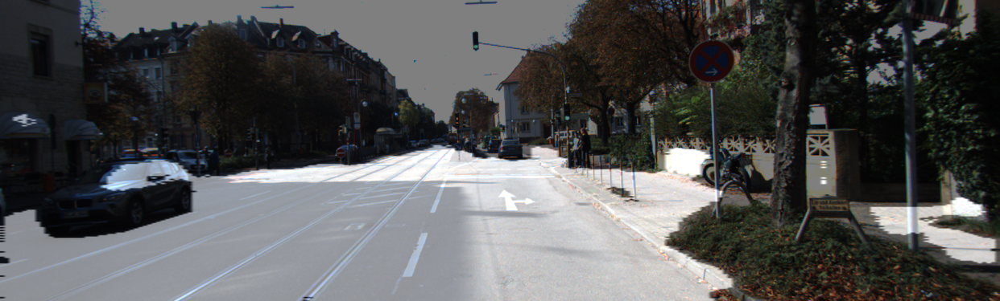

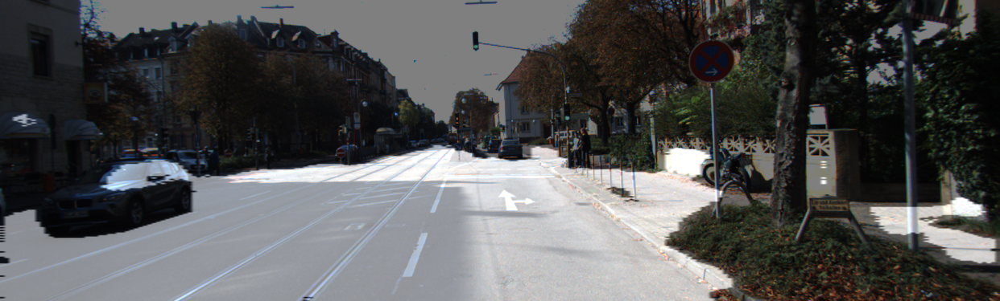

In [ ]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )

In [ ]:
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = float(np.sum(intersection)) / float(np.sum(union))
    print('IoU : %f' % iou_score )
    return iou_score

In [ ]:
def get_output_iou(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

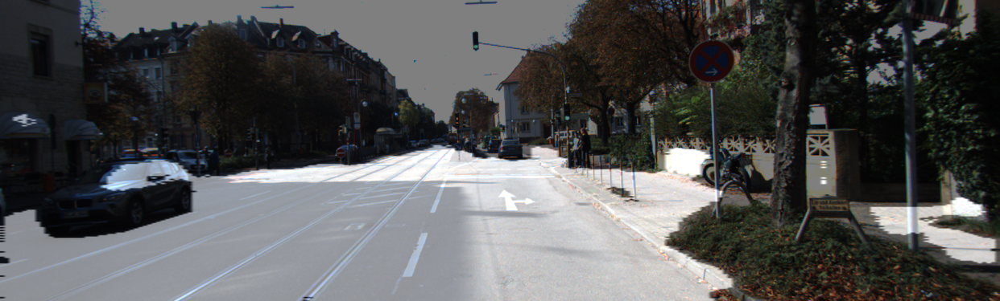

IoU : 0.810571


0.8105709624796085

In [ ]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
output, prediction, target = get_output_iou(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

calculate_iou_score(target, prediction)

# U-Net ++ 만들기

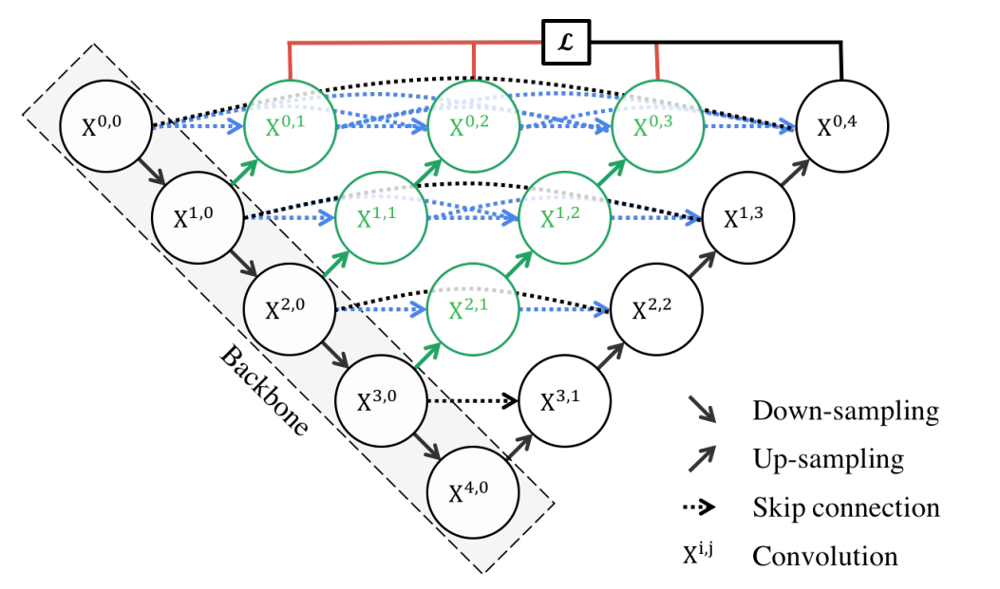

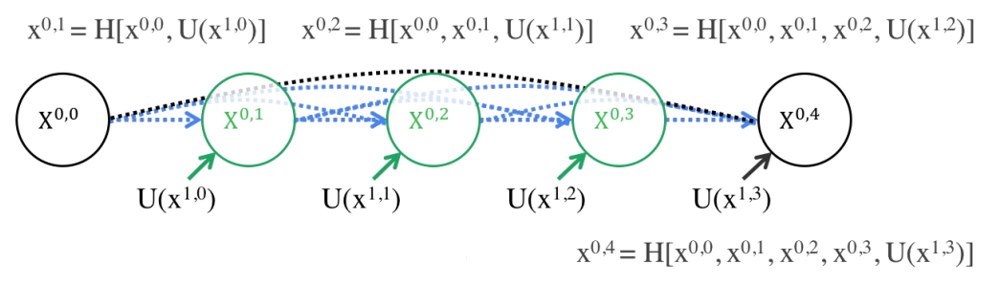

In [ ]:
def Unetpp(input_shape=(224,224,3), deep_supervision=True, batch_size=4):
  
    inputs = Input(input_shape)
    
    # Backbone
    # Convolution Node X(0,0) : Down-sampling
    conv0_0 = Conv2D(64, 3, padding='same', activation='relu', kernel_initializer='he_normal')(inputs)
    pool0_0 = MaxPooling2D(pool_size=(2, 2))(conv0_0)
    
    # Convolution Node X(1,0) : Down-sampling
    conv1_0 = Conv2D(128, 3, padding='same', activation='relu', kernel_initializer='he_normal')(pool0_0)
    pool1_0 = MaxPooling2D(pool_size=(2, 2))(conv1_0)
    
    # Convolution Node X(2,0) : Down-sampling
    conv2_0 = Conv2D(256, 3, padding='same', activation='relu', kernel_initializer='he_normal')(pool1_0)
    pool2_0 = MaxPooling2D(pool_size=(2, 2))(conv2_0)
    
    # Convolution Node X(3,0) : Down-sampling
    conv3_0 = Conv2D(512, 3, padding='same', activation='relu', kernel_initializer='he_normal')(pool2_0)
    pool3_0 = MaxPooling2D(pool_size=(2, 2))(conv3_0)
    
    # Convolution Node X(4,0) : Down-sampling
    conv4_0 = Conv2D(1024, 3, padding='same', activation='relu', kernel_initializer='he_normal')(pool3_0)
    pool4_0 = MaxPooling2D(pool_size=(2, 2))(conv4_0)
    


    # 첫번째 대각선
    # Node (x, y=1)
    # Convolution Node X(0,1) : Up-sampling and Skip Connection
    # Up-sampling : Node X(1,0)
    # Skip Connection : Node X(0,0)
    conv_up1_0 = Conv2DTranspose(64, 2, strides=(2, 2), activation='relu', kernel_initializer='he_normal')(conv1_0)
    merge0_1 = concatenate([conv_up1_0, conv0_0], axis=3)
    conv0_1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge0_1)
    
    # Convolution Node X(1,1) : Up-sampling and Skip Connection
    # Up-sampling : Node X(2,0)
    # Skip Connection : Node X(1,0)
    conv_up2_0 = Conv2DTranspose(128, 2, strides=(2, 2), activation='relu', kernel_initializer='he_normal')(conv2_0)
    merge1_1 = concatenate([conv_up2_0, conv1_0], axis=3)
    conv1_1 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge1_1)
    
    # Convolution Node X(2,1) : Up-sampling and Skip Connection
    # Up-sampling : Node X(3,0)
    # Skip Connection : Node X(2,0)
    conv_up3_0 = Conv2DTranspose(256, 2, strides=(2, 2), activation='relu', kernel_initializer='he_normal')(conv3_0)
    merge2_1 = concatenate([conv_up3_0, conv2_0], axis=3)
    conv2_1 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge2_1)
    
    # Convolution Node X(3,1) : Up-sampling and Skip Connection
    # Up-sampling : Node X(4,0)
    # Skip Connection : Node X(3,0)
    conv_up4_0 = Conv2DTranspose(512, 2, strides=(2, 2), activation='relu', kernel_initializer='he_normal')(conv4_0)
    merge3_1 = concatenate([conv_up4_0, conv3_0], axis=3)
    conv3_1 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge3_1)
    


    # 두번째 대각선
    # Node (x, y=2)
    # Convolution Node X(0,2) : Up-sampling and Skip Connection x2
    # Up-sampling : Node X(1,1)
    # Skip Connection : Node X(0,0), Node X(0,1)
    conv_up1_1 = Conv2DTranspose(64, 2, strides=(2, 2), activation='relu', kernel_initializer='he_normal')(conv1_1)
    merge0_2 = concatenate([conv_up1_1, conv0_0, conv0_1], axis=3)
    conv0_2 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge0_2)
    
    # Convolution Node X(1,2) : Up-sampling and Skip Connection x2
    # Up-sampling : Node X(2,1)
    # Skip Connection : Node X(1,0), Node X(1,1)
    conv_up2_1 = Conv2DTranspose(128, 2, strides=(2, 2), activation='relu', kernel_initializer='he_normal')(conv2_1)
    merge1_2 = concatenate([conv_up2_1, conv1_0, conv1_1], axis=3)
    conv1_2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge1_2)
    
    # Convolution Node X(2,2) : Up-sampling and Skip Connection x2
    # Up-sampling : Node X(3,1)
    # Skip Connection : Node X(2,0), Node X(2,1)
    conv_up3_1 = Conv2DTranspose(256, 2, strides=(2, 2), activation='relu', kernel_initializer='he_normal')(conv3_1)
    merge2_2 = concatenate([conv_up3_1, conv2_0, conv2_1], axis=3)
    conv2_2 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge2_2)
    


    # 세번째 대각선
    # Node (x, y=3)
    # Convolution Node X(0,3) : Up-sampling and Skip Connection x3
    # Up-sampling : Node X(1,2)
    # Skip Connection : Node X(0,0), Node X(0,1), Node X(0,2)
    conv_up1_2 = Conv2DTranspose(64, 2, strides = (2, 2), activation = 'relu', kernel_initializer='he_normal')(conv1_2)
    merge0_3 = concatenate([conv_up1_2, conv0_0, conv0_1, conv0_2], axis = 3)
    conv0_3 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge0_3)
    
    # Convolution Node X(0,3) : Up-sampling and Skip Connection x3
    # Up-sampling : Node X(2,2)
    # Skip Connection : Node X(1,0), Node X(1,1), Node X(1,2)
    conv_up2_2 = Conv2D(128, 2, activation='relu', padding='same', kernel_initializer='he_normal')(UpSampling2D(size=(2, 2))(conv2_2))
    # conv_up2_2 = Conv2DTranspose(128, 2, strides = (2, 2), activation = 'relu', kernel_initializer='he_normal')(conv2_2)
    merge1_3 = concatenate([conv_up2_2, conv1_0, conv1_1, conv1_2], axis = 3)
    conv1_3 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge1_3)
    


    # 네번째 대각선
    # Node (x, y=4)
    # Convolution Node X(0,4) : Up-sampling and Skip Connection x4
    # Up-sampling : Node X(1,3)
    # Skip Connection : Node X(0,0), Node X(0,1), Node X(0,2), Node X(0,3)
    conv_up1_3 = Conv2D(64, 2, activation='relu', padding='same', kernel_initializer='he_normal')(UpSampling2D(size=(2, 2))(conv1_3))
    # conv_up1_3 = Conv2DTranspose(64, 2, strides = (2, 2), activation = 'relu', kernel_initializer='he_normal')(conv1_3)
    merge0_4 = concatenate([conv_up1_3, conv0_0, conv0_1, conv0_2, conv0_3], axis=3)
    conv0_4 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge0_4)



    # deep_supervision
    output1 = Conv2D(1, 1, activation='sigmoid', name = 'output1')(conv0_1)
    output2 = Conv2D(1, 1, activation='sigmoid', name = 'output2')(conv0_2)
    output3 = Conv2D(1, 1, activation='sigmoid', name = 'output3')(conv0_3)
    output4 = Conv2D(1, 1, activation='sigmoid', name = 'output4')(conv0_4)
    
    if deep_supervision:
        model = Model(inputs=inputs, outputs=[output1, output2, output3, output4])
    else:
        model = Model(inputs=inputs, outputs=output4)

    return model

In [ ]:
unet_plus_plus_not=Unetpp(deep_supervision=False)
unet_plus_plus_not.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, 224, 224, 64) 1792        input_2[0][0]                    
__________________________________________________________________________________________________
max_pooling2d_4 (MaxPooling2D)  (None, 112, 112, 64) 0           conv2d_20[0][0]                  
__________________________________________________________________________________________________
conv2d_21 (Conv2D)              (None, 112, 112, 128 73856       max_pooling2d_4[0][0]            
____________________________________________________________________________________________

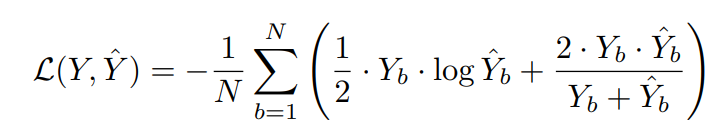

In [ ]:
# Custom loss function
def dice_coef(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_coef_loss(y_true, y_pred):
    return 1. - dice_coef(y_true, y_pred)

def bce_dice_loss(y_true, y_pred):
    return 0.5 * keras.losses.binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

In [ ]:
unet_plus_plus_not.compile(optimizer = Adam(1e-4), loss='binary_crossentropy')
unet_plus_plus_not.fit(
    x=train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
 )

model_path = '/content/drive/MyDrive/semantic_segmentation/training/seg_model_unet_pp_notsuper.h5'
unet_plus_plus_not.save(model_path)

Epoch 1/100
11/11 [==============================] - 30s 1s/step - loss: 0.6864 - val_loss: 0.6699
Epoch 2/100
11/11 [==============================] - 14s 1s/step - loss: 0.6599 - val_loss: 0.5861
Epoch 3/100
11/11 [==============================] - 14s 1s/step - loss: 0.3398 - val_loss: 0.0411
Epoch 4/100
11/11 [==============================] - 14s 1s/step - loss: 0.0334 - val_loss: 0.0429
Epoch 5/100
11/11 [==============================] - 14s 1s/step - loss: 0.0350 - val_loss: 0.0303
Epoch 6/100
11/11 [==============================] - 13s 1s/step - loss: 0.0406 - val_loss: 0.0287
Epoch 7/100
11/11 [==============================] - 13s 1s/step - loss: 0.0304 - val_loss: 0.0285
Epoch 8/100
11/11 [==============================] - 13s 1s/step - loss: 0.0296 - val_loss: 0.0339
Epoch 9/100
11/11 [==============================] - 13s 1s/step - loss: 0.0303 - val_loss: 0.0341
Epoch 10/100
11/11 [==============================] - 13s 1s/step - loss: 0.0313 - val_loss: 0.0277
Epoch 11/

In [ ]:
model_path = '/content/drive/MyDrive/semantic_segmentation/training/seg_model_unet_pp_notsuper.h5' 

seg_model_unet_pp_notsuper = tf.keras.models.load_model(model_path)

In [ ]:
unet_model_path = '/content/drive/MyDrive/semantic_segmentation/training/seg_model_unet.h5'
unet_pp_not_path = '/content/drive/MyDrive/semantic_segmentation/training/seg_model_unet_pp_notsuper.h5'

In [ ]:
unet_model = tf.keras.models.load_model(unet_model_path)
unetpp_not_model= tf.keras.models.load_model(unet_pp_not_path)

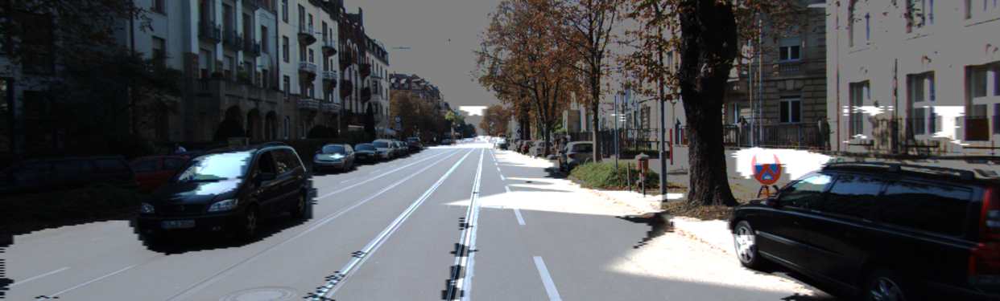

IoU : 0.847442


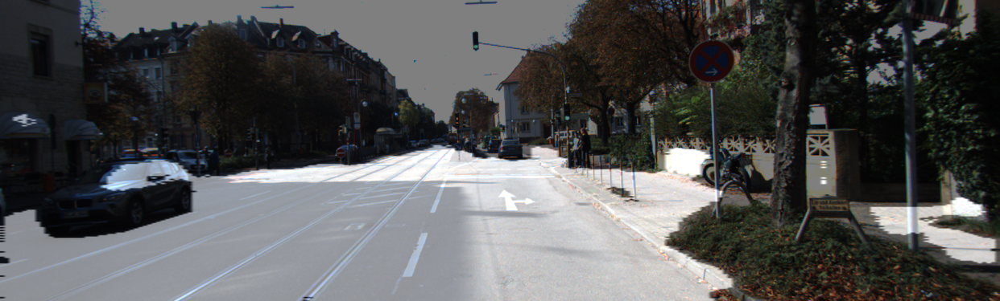

IoU : 0.810571


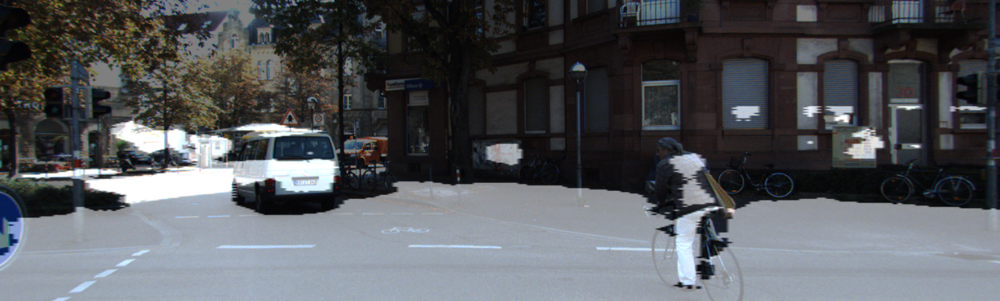

IoU : 0.600169


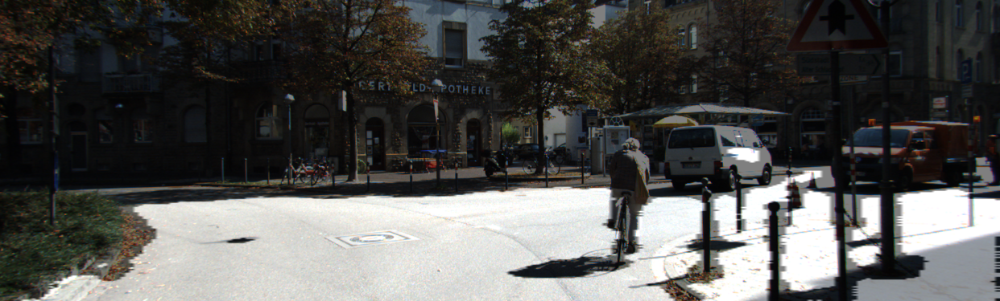

IoU : 0.617983


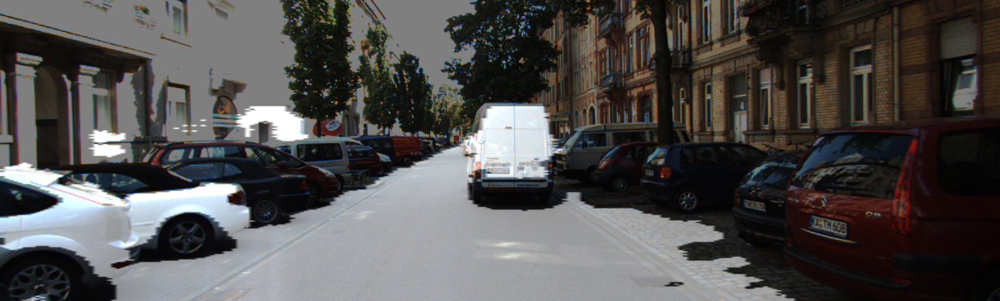

IoU : 0.505484


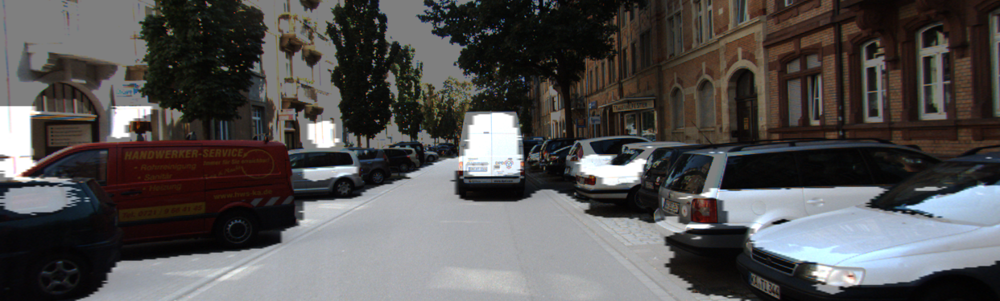

IoU : 0.444469


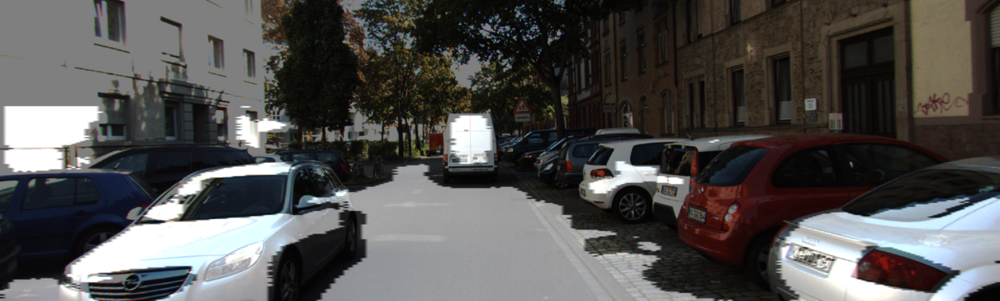

IoU : 0.342600


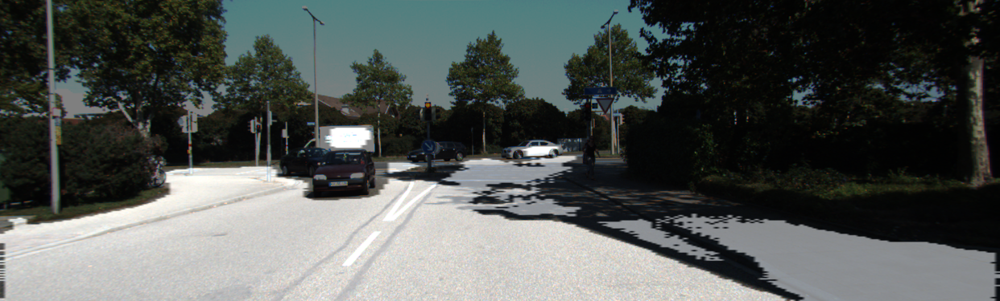

IoU : 0.654821


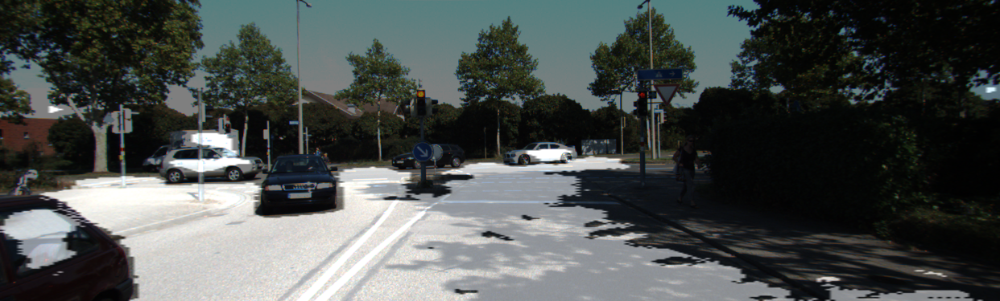

IoU : 0.719410


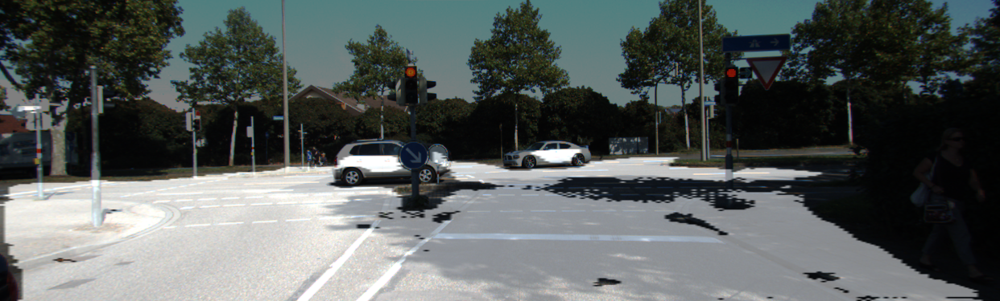

IoU : 0.711145


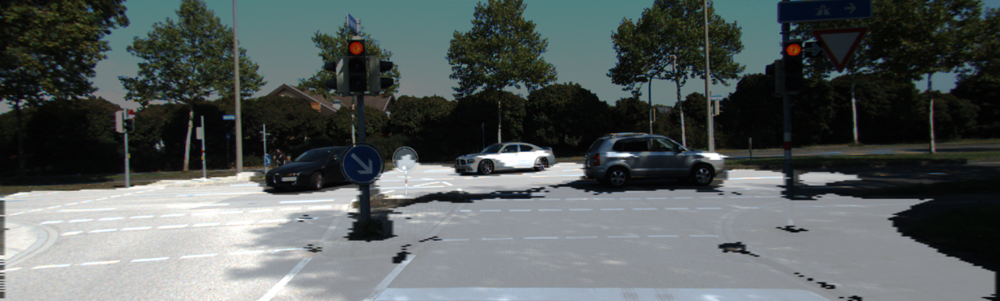

IoU : 0.692191


In [ ]:
unet_iou = []
for i in range(20):
    output, prediction, target = get_output_iou(unet_model, 
                                            test_preproc, 
                                            image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                                            output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                                            label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                           )
    unet_iou.append(calculate_iou_score(target, prediction))

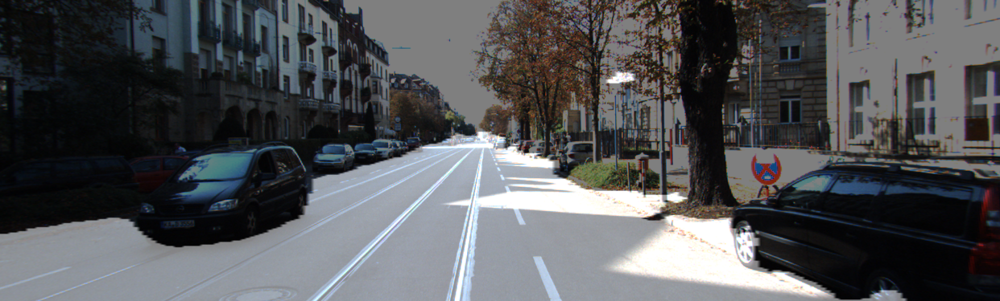

IoU : 0.909757


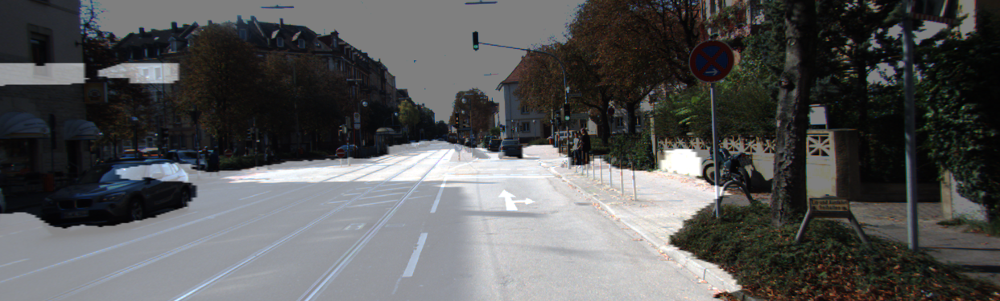

IoU : 0.805086


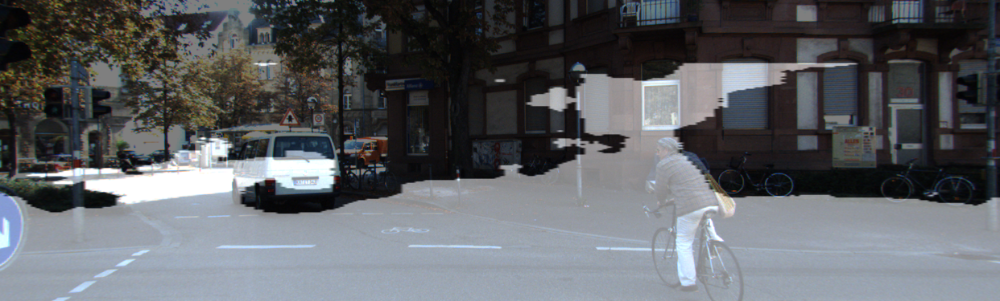

IoU : 0.514451


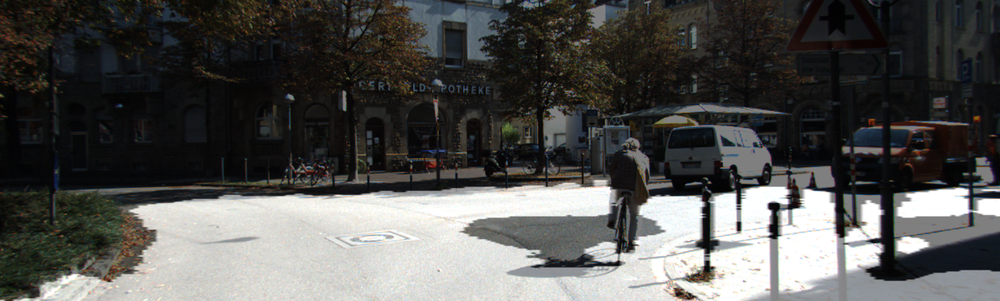

IoU : 0.585947


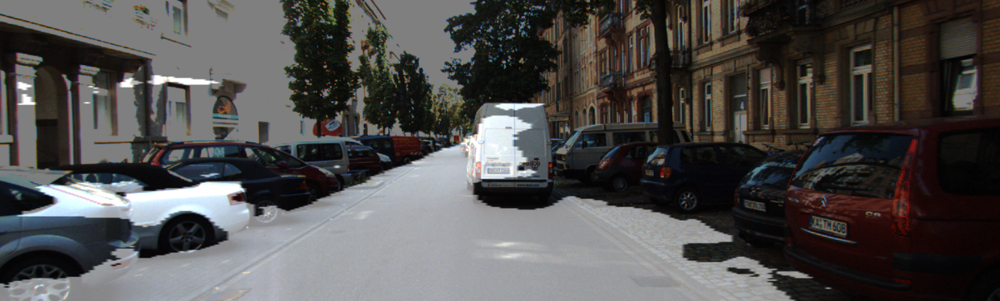

IoU : 0.519427


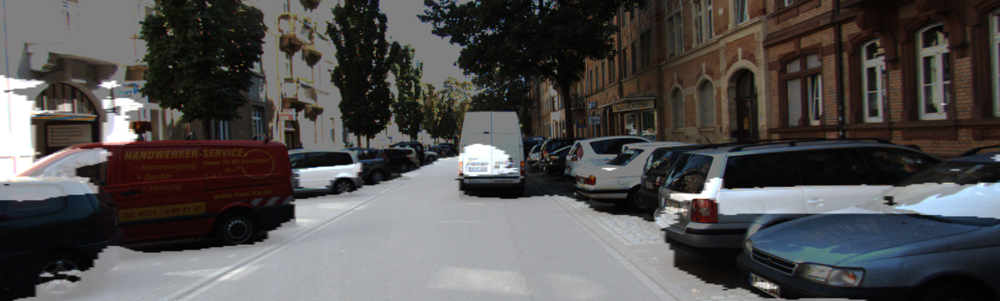

IoU : 0.484292


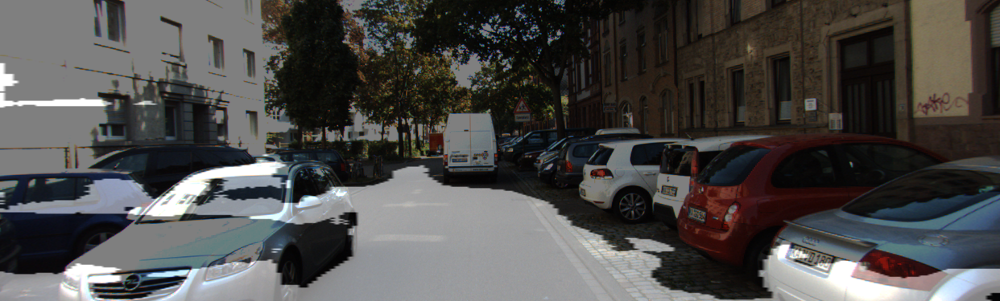

IoU : 0.433482


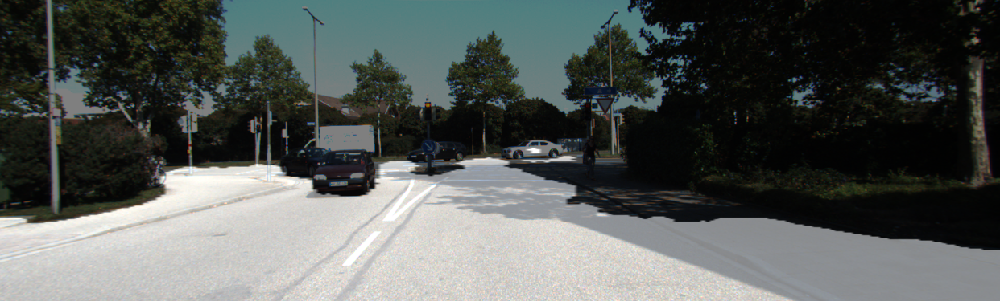

IoU : 0.712673


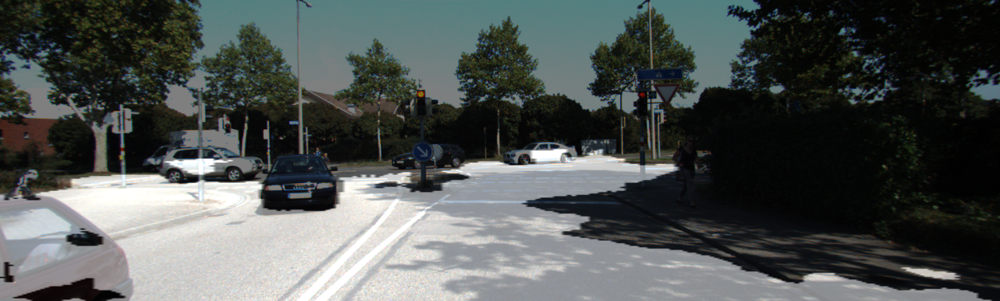

IoU : 0.677897


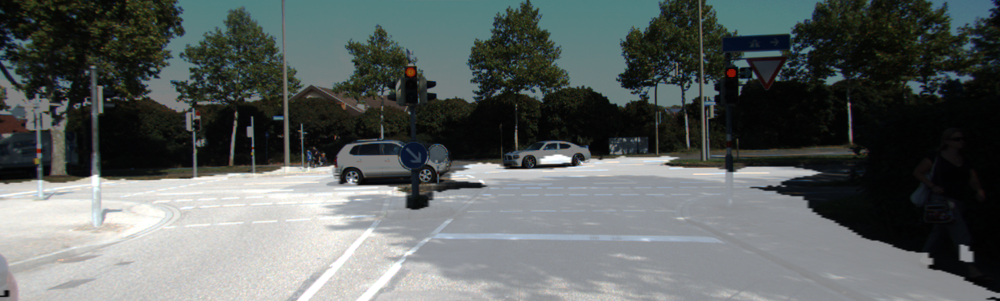

IoU : 0.723167


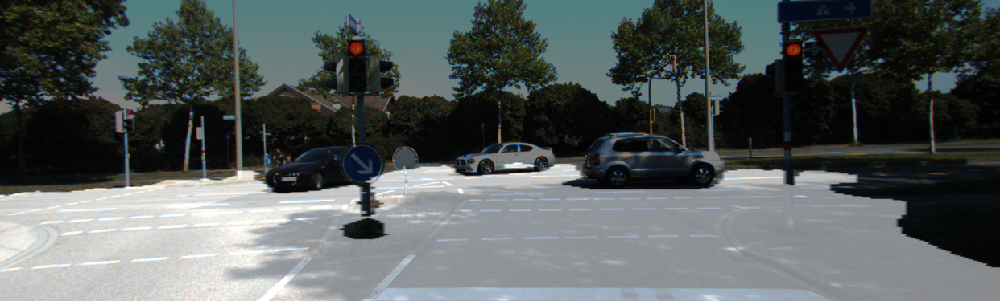

IoU : 0.701155


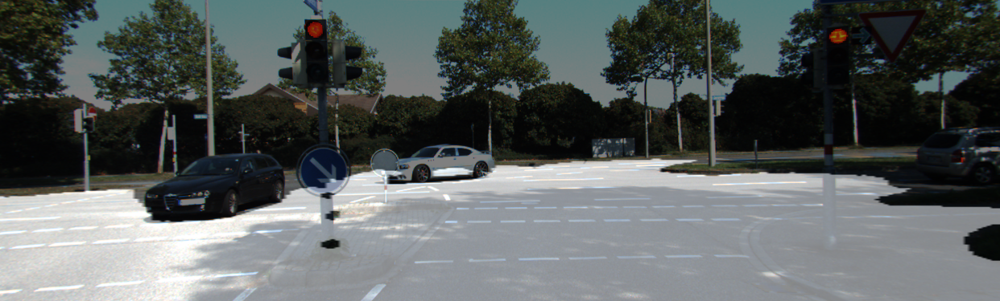

IoU : 0.694598


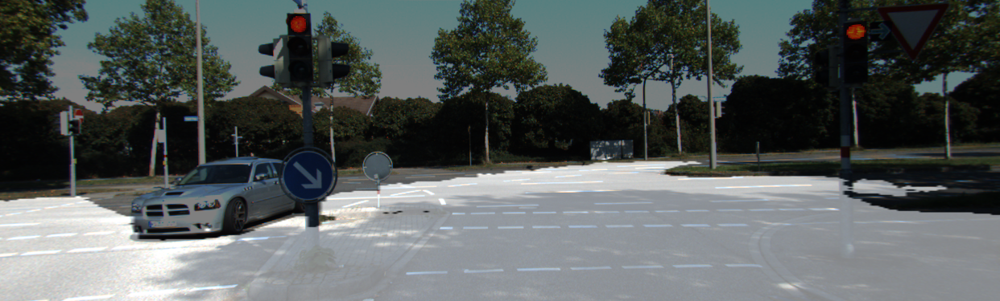

IoU : 0.651774


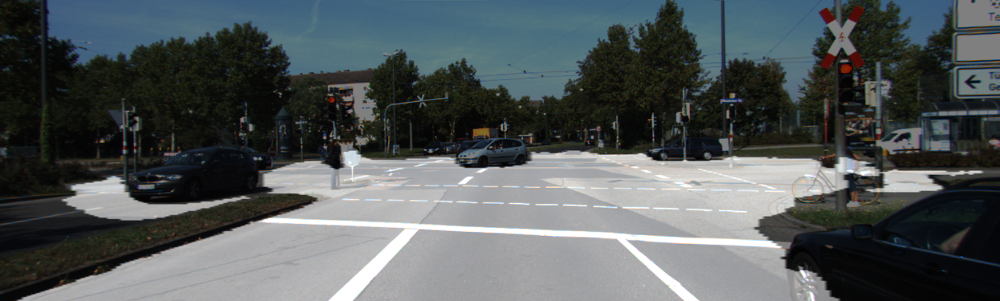

IoU : 0.859774


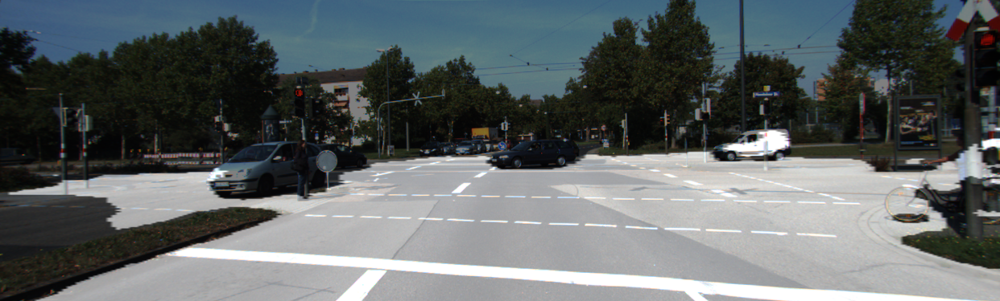

IoU : 0.836044


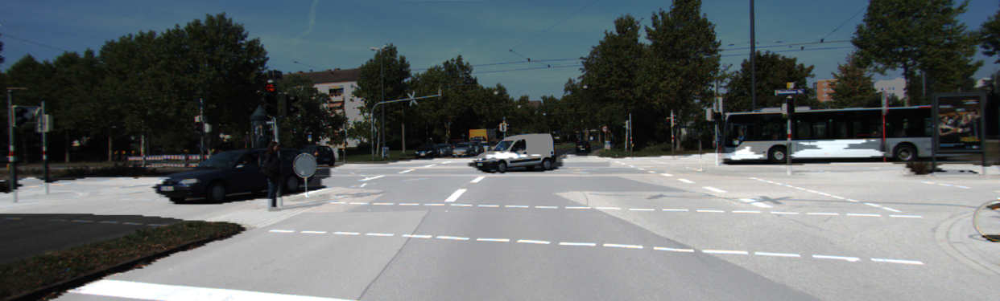

IoU : 0.837071


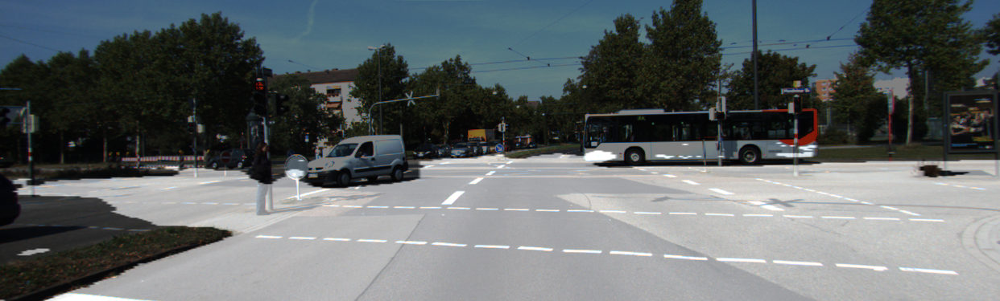

IoU : 0.844204


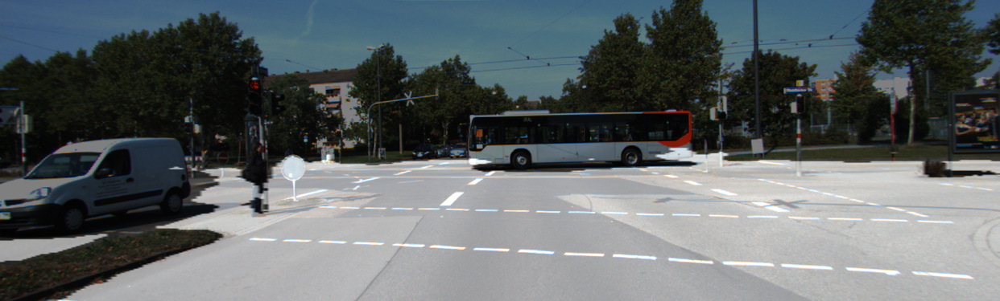

IoU : 0.880129


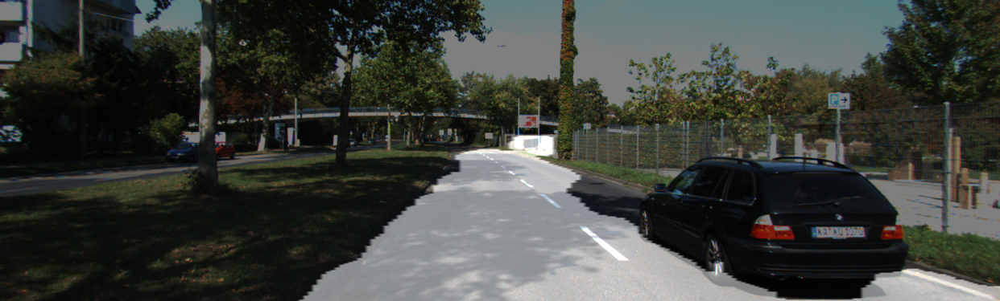

IoU : 0.752764


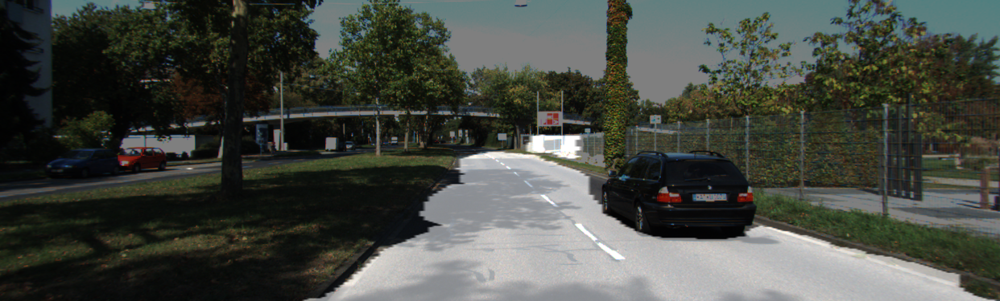

IoU : 0.844977


In [ ]:
unetpp_not_iou = []
for i in range(20):
    output, prediction, target = get_output_iou(unetpp_not_model, 
                                            test_preproc, 
                                            image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
                                            output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
                                            label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
                                           )
    unetpp_not_iou.append(calculate_iou_score(target, prediction))

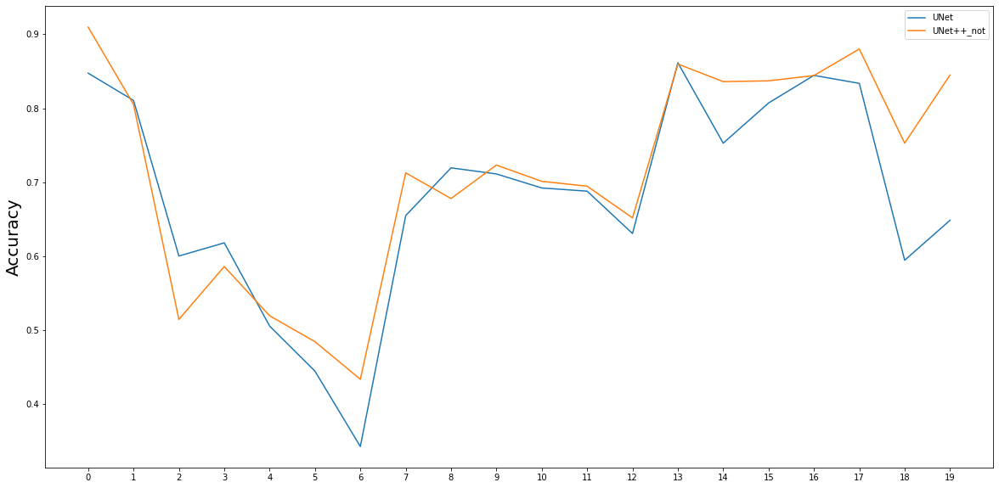

In [36]:
plt.figure(figsize=(20, 10))
plt.plot(unet_iou, label='UNet')
plt.plot(unetpp_not_iou, label='UNet++_not')

plt.ylabel('Accuracy', size=20)
plt.xticks(range(20), range(20))
plt.legend()

# 출처
https://github.com/museonghwang/AIFFEL/blob/master/GoingDeeper_10/%5BGD_10%5D_Creating_an_improved_U_Net_model.ipynb

https://jinmay.github.io/2019/11/26/python/python-instance-slice/

https://ooyoung.tistory.com/99



# 회고

- 세션 관리를 똑바로 해야겠다. GPU를 남발하여 사용했더니 사용 가능한 GPU가 모자라다는 경고가 떴다.
- detection노드보다 쉽다고 느껴졌다. 여유롭게 공부했던 것 같다.
- 나름 논문 구현을 해보기도 했고 upsampling할 때 왜 (2,2)를 사용하는지 알 수 있었다.
- 쓰는 도중에도 연결이 끊긴다. 미칠 것 같다. 결국 컴퓨팅 단위 구매했다.피 같은 내 돈